<a href="https://colab.research.google.com/github/YonDraco/ftech_ai/blob/main/Final_RFM_segmentation_T11.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Import library

In [1]:
!pip install pyod

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 147 kB 4.9 MB/s 
  Created wheel for pyod: filename=pyod-1.0.7-py3-none-any.whl size=181101 sha256=4e91ef2425f857684a94179e3d1e6b8261bda01e025449b992d2ef09e76ffbcd
  Stored in directory: /root/.cache/pip/wheels/f7/e2/c1/1c7fd8b261e72411f6509afb429c84532e40ddcd96074473f4
Successfully built pyod


In [2]:
import numpy as np 
import pandas as pd 
import plotly.express as px
import matplotlib.pyplot as plt
from sklearn.ensemble import IsolationForest
from sklearn.model_selection import train_test_split

import seaborn as sns
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans

# Set visualization style
sns.set_style("darkgrid")

# EDA

#### Read dataframe

In [3]:
df_all = pd.read_csv("/content/drive/MyDrive/FTECHAI/dataset/T11/df_all_T11.csv")
df_paid = pd.read_csv("/content/drive/MyDrive/FTECHAI/dataset/T11/df_paid_T11.csv")

In [4]:
df_all.describe()

,duration,monetary,frequency,recency
count,174138.000000,174138.000000,174138.000000,174138.000000
mean,37.737725,11.002768,2.953198,13.096280
std,46.942768,322.287742,4.487542,9.092263
min,0.047900,0.000000,1.000000,0.000000
25%,12.475029,0.000000,1.000000,4.000000
50%,24.490731,0.000000,1.000000,12.000000
75%,45.280566,0.000000,3.000000,21.000000
max,1955.440636,48550.000000,30.000000,29.000000


In [5]:
df_all

,account_id,duration,monetary,frequency,recency
0,62a02cd3a3815feccbb7915a,5.237117,0,3,14
1,62a2e9d7a3815feccbb79179,30.814383,0,1,2
2,62a3a777a3815feccbb7917e,2.033133,0,1,5
3,62a69da1a3815feccbb79184,2.011192,0,2,1
4,62a6eb19a3815feccbb79188,8.838725,0,2,5
...,...,...,...,...,...
174133,638789c11505f828cf7babae,6.490567,0,1,0
174134,638789e31505f828cf7babaf,57.539951,0,1,0
174135,63878afb1505f828cf7babb0,19.862101,0,1,0
174136,63878bc01505f828cf7babb1,1.227600,0,1,0


In [6]:
df_paid.describe()

,duration,monetary,frequency,recency
count,1520.000000,1520.000000,1520.000000,1520.000000
mean,147.770254,1260.526316,18.626974,3.597368
std,112.262612,3214.251570,10.705818,6.612952
min,1.341000,100.000000,1.000000,0.000000
25%,72.007921,100.000000,8.000000,0.000000
50%,119.151877,450.000000,21.500000,0.000000
75%,190.751053,1100.000000,29.000000,4.000000
max,965.718251,48550.000000,30.000000,29.000000


In [7]:
df_paid

,account_id,duration,monetary,frequency,recency
0,62d80d181505f84bf054dbbe,13.771275,100,2,16
1,62d80d601505f84bf054dbd6,36.422684,100,18,0
2,62d80df01505f84bf054dc0e,153.541390,100,19,0
3,62d80ea81505f84bf054dc59,172.837959,100,24,0
4,62d80efb1505f84bf054dc77,211.213087,1100,17,8
...,...,...,...,...,...
1515,63869ca11505f828cf7ba07f,102.760166,100,1,0
1516,6386c5151505f828cf7ba193,27.815368,100,1,0
1517,6386c7a51505f828cf7ba1aa,73.044750,100,1,0
1518,6386ee331505f828cf7ba3cb,159.042616,100,1,0


In [8]:
dfa_dropid = df_all.drop(columns = 'account_id')
dfp_dropid = df_paid.drop(columns = 'account_id')

#### Draw

##### Heatmap

Text(0.5, 1.0, 'Heatmap')

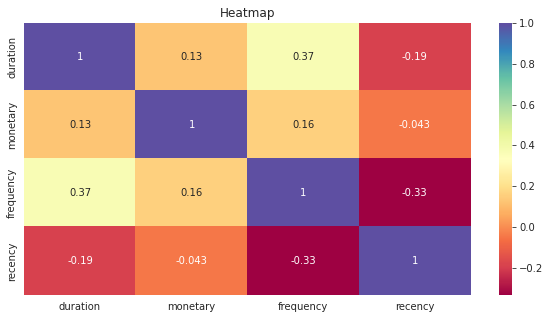

In [9]:
plt.figure(figsize=(10,5))
sns.heatmap(dfa_dropid.corr(), annot=True, cmap='Spectral')
plt.title("Heatmap")

Text(0.5, 1.0, 'Heatmap')

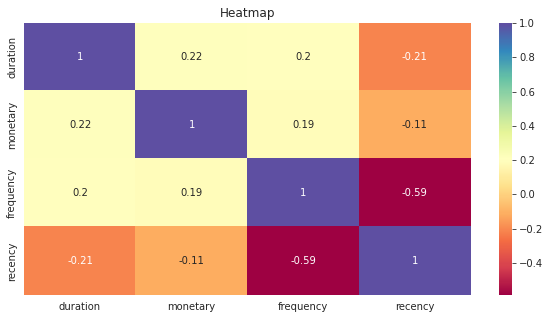

In [10]:
plt.figure(figsize=(10,5))
sns.heatmap(dfp_dropid.corr(), annot=True, cmap='Spectral')
plt.title("Heatmap")

##### Pairplot

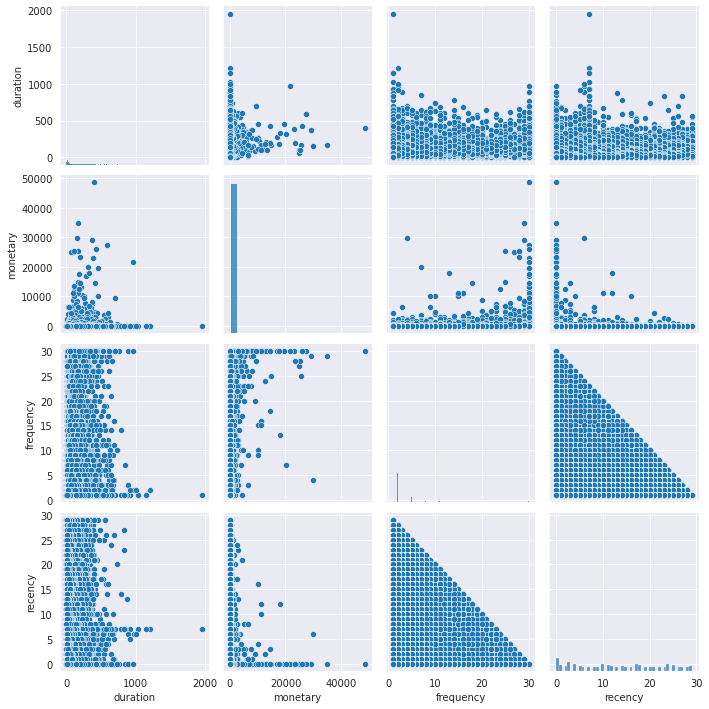

In [11]:
sns.pairplot(dfa_dropid, kind="scatter")
plt.show()

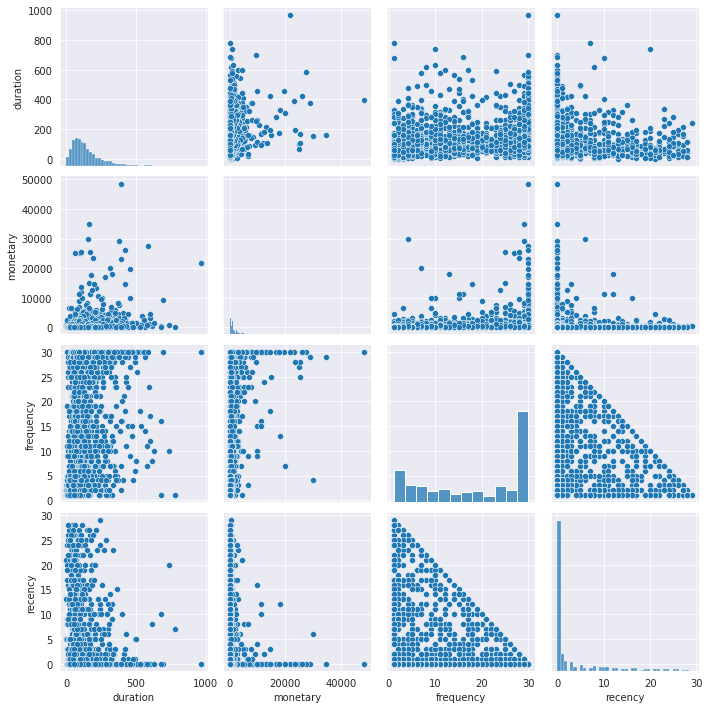

In [12]:
sns.pairplot(dfp_dropid, kind="scatter")
plt.show()

##### Distribution visualization

###### df_all

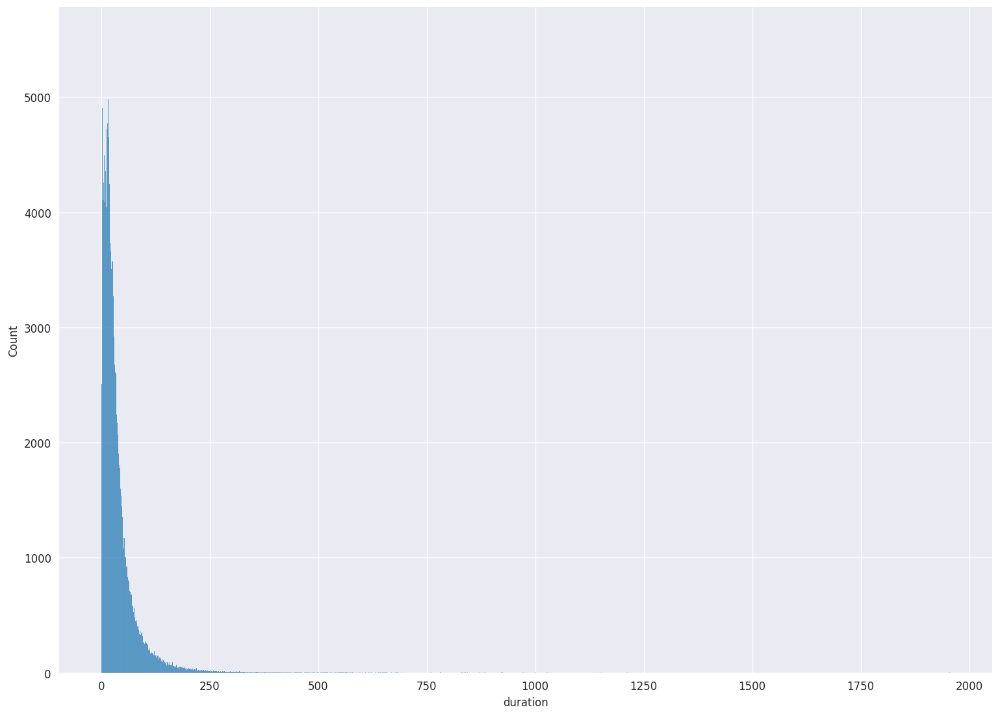

In [13]:
p = sns.displot(dfa_dropid['duration'])
p.fig.set_figwidth(15)
p.fig.set_figheight(10)
p.fig.set_dpi(120)

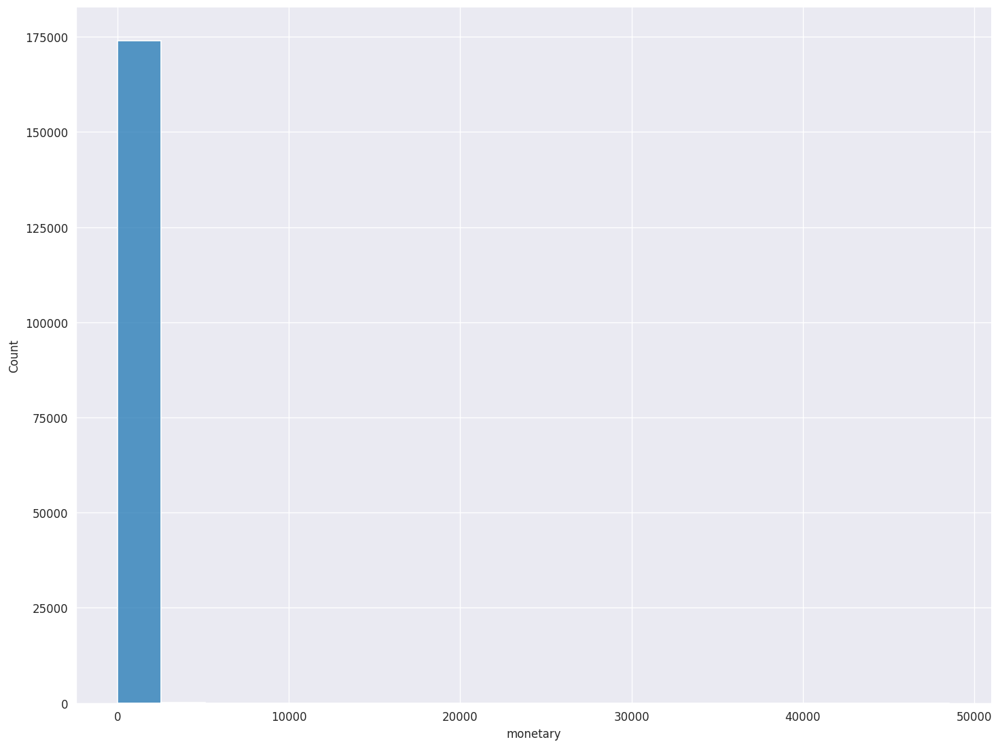

In [14]:
p = sns.displot(dfa_dropid['monetary'])
p.fig.set_figwidth(15)
p.fig.set_figheight(10)
p.fig.set_dpi(120)

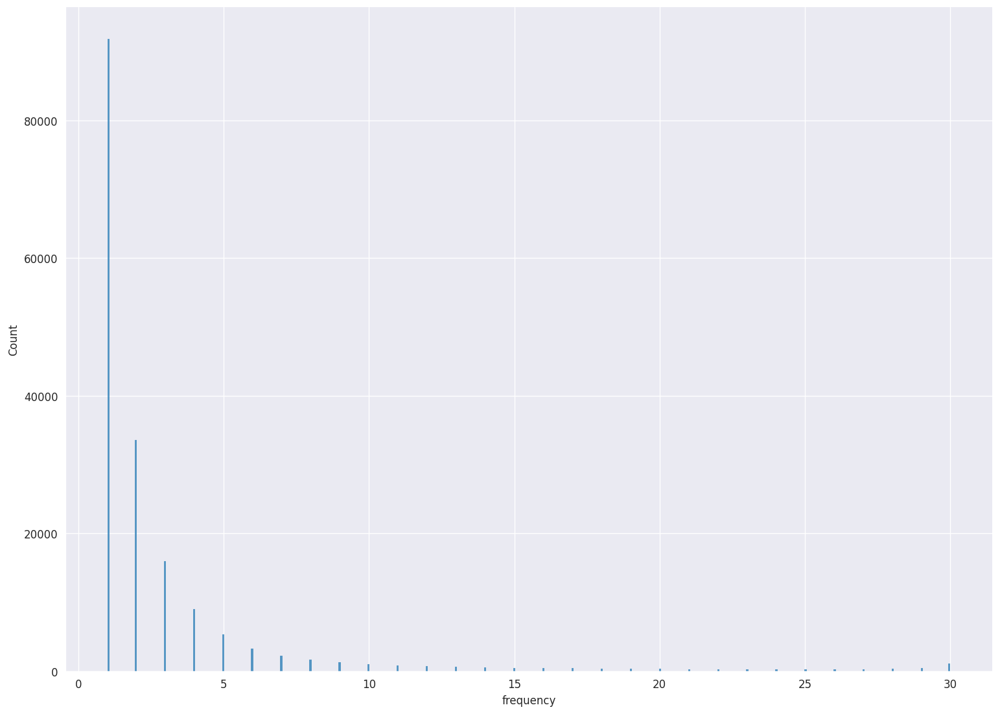

In [15]:
p = sns.displot(dfa_dropid['frequency'])
p.fig.set_figwidth(15)
p.fig.set_figheight(10)
p.fig.set_dpi(120)

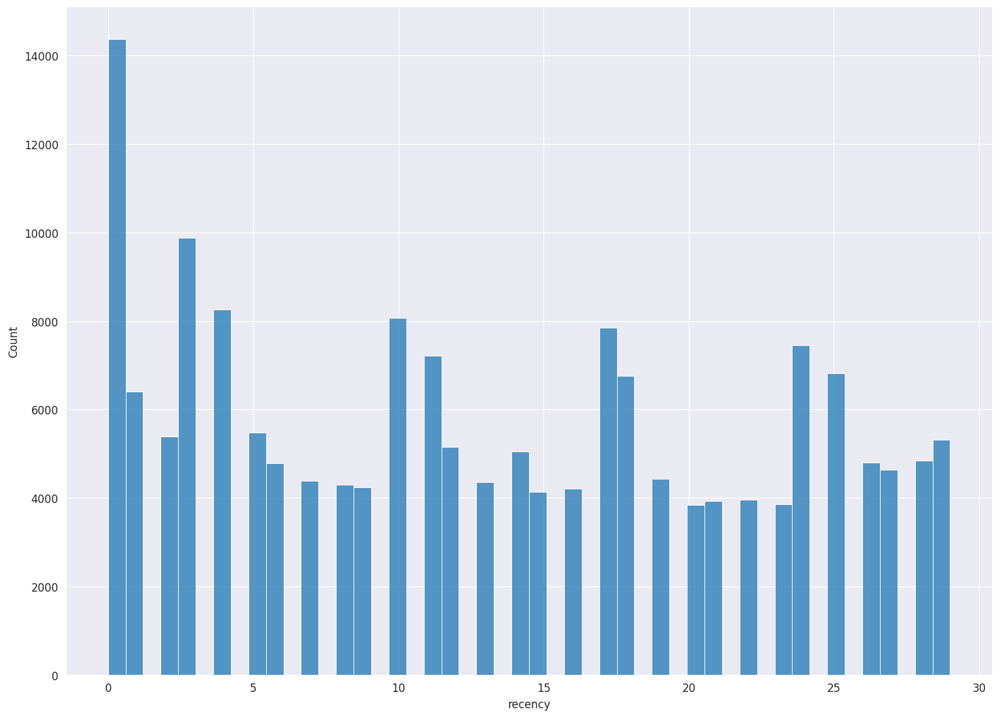

In [16]:
p = sns.displot(dfa_dropid['recency'])
p.fig.set_figwidth(15)
p.fig.set_figheight(10)
p.fig.set_dpi(120)

###### df_paid

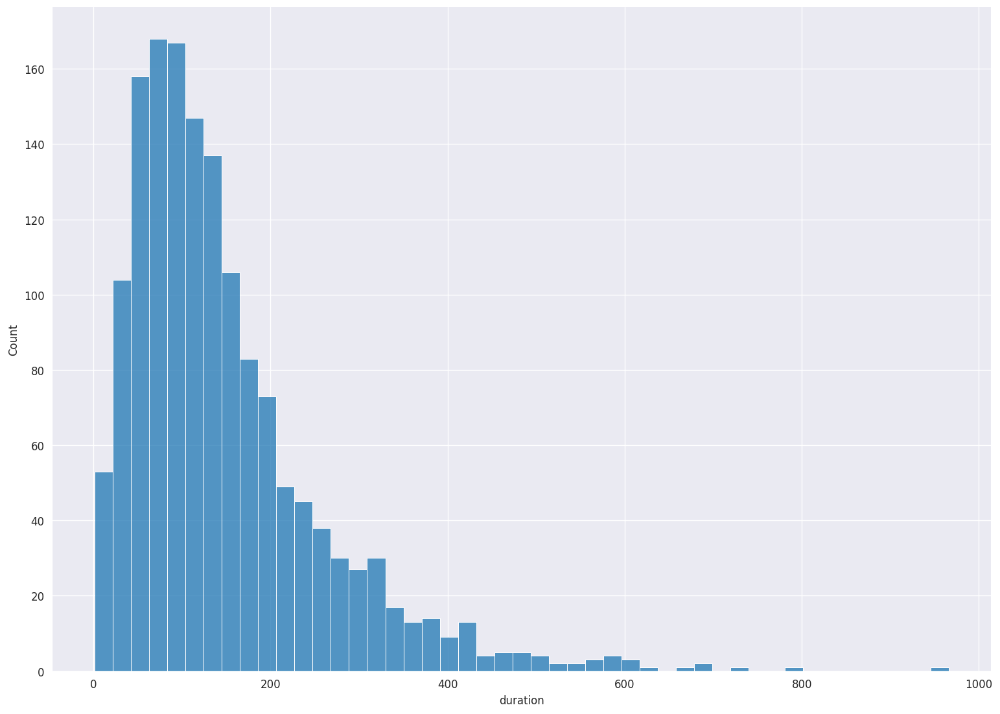

In [17]:
p = sns.displot(dfp_dropid['duration'])
p.fig.set_figwidth(15)
p.fig.set_figheight(10)
p.fig.set_dpi(120)

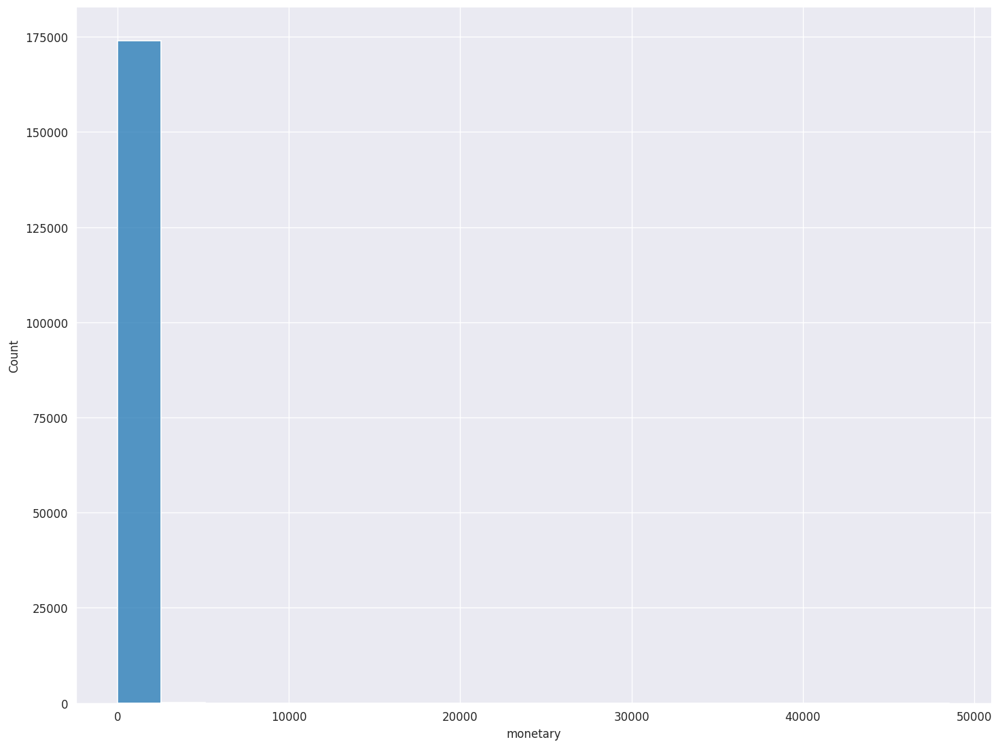

In [18]:
p = sns.displot(dfa_dropid['monetary'])
p.fig.set_figwidth(15)
p.fig.set_figheight(10)
p.fig.set_dpi(120)

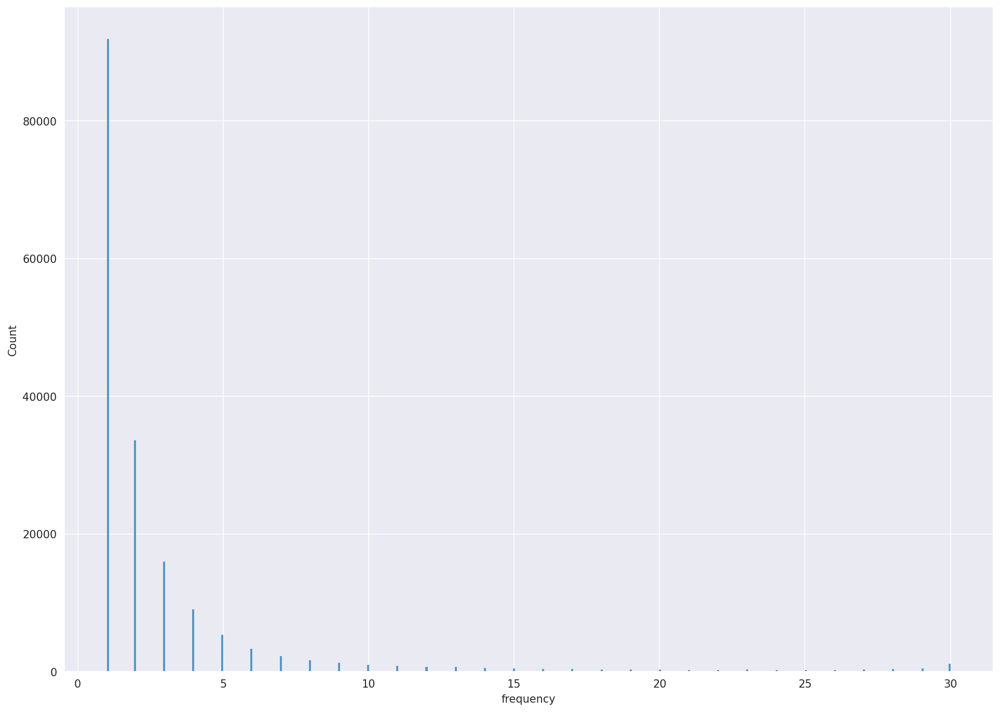

In [19]:
p = sns.displot(dfa_dropid['frequency'])
p.fig.set_figwidth(15)
p.fig.set_figheight(10)
p.fig.set_dpi(150)

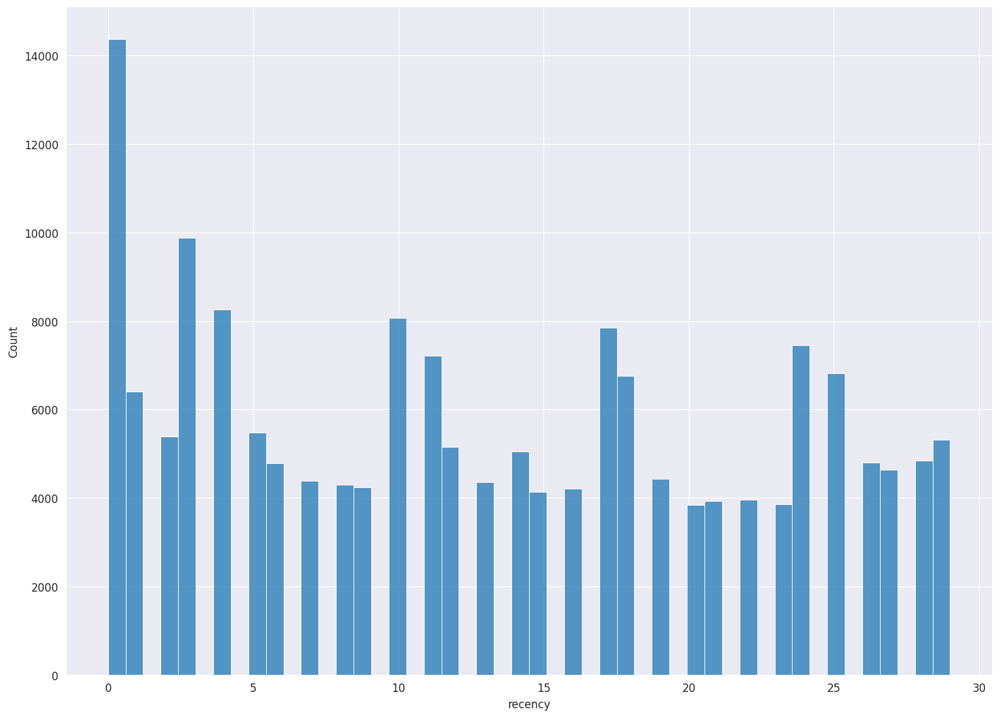

In [20]:
p = sns.displot(dfa_dropid['recency'])
p.fig.set_figwidth(15)
p.fig.set_figheight(10)
p.fig.set_dpi(120)

# Process noise

### Duration
Một session có thời gian chơi khoảng 2p nên các value duration <2 sẽ được coi là noise và tiến hành loại bỏ

In [21]:
# Get value with condition
dfa_dropid_rn = dfa_dropid[dfa_dropid.duration >2]
# dfp_dropid_rn = dfp_dropid[dfp_dropid.duration >2]

In [22]:
dfa_dropid_rn.describe()

,duration,monetary,frequency,recency
count,169688.000000,169688.000000,169688.000000,169688.000000
mean,38.697761,11.283945,3.002292,13.015965
std,47.173503,326.474283,4.534172,9.083734
min,2.000317,0.000000,1.000000,0.000000
25%,13.340757,0.000000,1.000000,4.000000
50%,25.230567,0.000000,1.000000,12.000000
75%,46.124868,0.000000,3.000000,21.000000
max,1955.440636,48550.000000,30.000000,29.000000


# Process outliers

## Method quan sát

### Duration

In [23]:
df_boxplot = pd.DataFrame(dfa_dropid_rn['duration'])
fig = px.box(df_boxplot)
fig.show()

### Monetary

In [24]:
df_boxplot = pd.DataFrame(df_paid['monetary'])
fig = px.box(df_boxplot)
fig.show()

## Method IQR

### Duration

In [25]:
Q1 = dfa_dropid_rn['duration'].quantile(0.25)
Q3 = dfa_dropid_rn['duration'].quantile(0.75)
IQR = Q3 - Q1
lower = Q1 - 1.5*IQR
upper = Q3 + 1.5*IQR

In [26]:
outlier= dfa_dropid_rn[(dfa_dropid_rn['duration'] < lower) | (dfa_dropid_rn['duration'] > upper)]

In [27]:
outlier['duration'].describe()

count    12926.000000
mean       161.912027
std         86.097316
min         95.311297
25%        110.294041
50%        133.444701
75%        179.691094
max       1955.440636
Name: duration, dtype: float64

In [28]:
outlier['duration'].to_csv("T11_iqr_od.csv")

### Monetary

In [32]:
Q1 = df_paid['monetary'].quantile(0.25)
Q3 = df_paid['monetary'].quantile(0.75)
IQR = Q3 - Q1
lower = Q1 - 1.5*IQR
upper = Q3 + 1.5*IQR

In [33]:
outlier= df_paid[(df_paid['monetary'] < lower) | (df_paid['monetary'] > upper)]

In [34]:
outlier['monetary'].describe()

count      147.000000
mean      7724.489796
std       7579.508621
min       2650.000000
25%       3350.000000
50%       4600.000000
75%       8000.000000
max      48550.000000
Name: monetary, dtype: float64

In [35]:
outlier['monetary'].to_csv("T11_iqr_om.csv")

## Method standard deviation, z-score

In [37]:
from scipy.stats import zscore

### Duration

In [38]:
scores = zscore(dfa_dropid_rn)
is_over_3 = np.abs(scores) > 3
outliers_d = dfa_dropid_rn[is_over_3]

In [39]:
outliers_d = pd.DataFrame(outliers_d)
outliers_d["duration"].describe()

count    3205.000000
mean      271.701064
std       110.803288
min       180.238310
25%       201.913048
50%       235.662028
75%       302.572399
max      1955.440636
Name: duration, dtype: float64

In [40]:
outliers_d['duration'].to_csv("T11_z_od.csv")

### Monetary

In [44]:
scores = zscore(dfp_dropid)
is_over_3 = np.abs(scores) > 3
outliers_m = df_paid[is_over_3]

In [45]:
outliers_m = pd.DataFrame(outliers_m)
outliers_m["monetary"].describe()

count       28.000000
mean     20903.571429
std       8526.721924
min      11100.000000
25%      14262.500000
50%      19825.000000
75%      25325.000000
max      48550.000000
Name: monetary, dtype: float64

In [46]:
outliers_m['monetary'].to_csv("T11_z_om.csv")

## Method: MAD

In [ ]:
from scipy.stats import median_abs_deviation
from pyod.models.mad import MAD

In [ ]:
df_mad_d = pd.read_csv("/content/drive/MyDrive/FTECHAI/dataset/T9/duration_mad.csv")
df_mad_m = pd.read_csv("/content/drive/MyDrive/FTECHAI/dataset/T9/monetary_mad.csv")

### Duration

In [ ]:
df_mad_d = df_mad_d[df_mad_d.duration >2]

In [ ]:
df_mad_d.describe()

,duration
count,395571.000000
mean,38.210368
std,47.058588
min,2.000017
25%,15.034725
50%,24.590700
75%,45.212269
max,3756.223764


In [ ]:
mad_score = median_abs_deviation(df_mad_d['duration'])
mad_score
# có thể thay thế giá trị này thay cho std trong công thức z-score

13.10220051

In [ ]:
mad = MAD(threshold=19.5)

df_mad_d_reshaped = df_mad_d.values.reshape(-1, 1)
labels = mad.fit_predict(df_mad_d_reshaped)

# Filter outliers
outliers = df_mad_d[labels == 1]

print(len(outliers))

564


/usr/local/lib/python3.8/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function fit_predict is deprecated
  warnings.warn(msg, category=FutureWarning)


In [ ]:
outliers = pd.DataFrame(outliers)
outliers.describe()

,duration
count,564.000000
mean,596.845893
std,316.016769
min,403.448229
25%,441.079416
50%,491.943160
75%,607.416022
max,3756.223764


### Monetary

In [ ]:
mad_score = median_abs_deviation(df_mad_m['monetary'])
mad_score

200.0

In [ ]:
mad = MAD(threshold=50)

df_mad_d_reshaped = df_mad_d.values.reshape(-1, 1)
labels = mad.fit_predict(df_mad_d_reshaped)

# Filter outliers
outliers = df_mad_d[labels == 1]

print(len(outliers))

37


/usr/local/lib/python3.8/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function fit_predict is deprecated
  warnings.warn(msg, category=FutureWarning)


In [ ]:
outliers = pd.DataFrame(outliers)
outliers.describe()

,duration
count,37.000000
mean,1518.332821
std,603.628295
min,1063.542114
25%,1164.858276
50%,1184.009399
75%,1865.953616
max,3756.223764


## Method IsolationForest

In [47]:
from sklearn.ensemble import IsolationForest
from sklearn.model_selection import train_test_split

### Duration

In [48]:
dfa_dropid_rn.head()

,duration,monetary,frequency,recency
0,5.237117,0,3,14
1,30.814383,0,1,2
2,2.033133,0,1,5
3,2.011192,0,2,1
4,8.838725,0,2,5


In [49]:
df = dfa_dropid_rn

In [51]:
CONTAMINATION=.03
#.1   
BOOTSTRAP = False   

data = df.values

# X, y = data[:, :-1], data[:, -1]
X, y = data[:, :], data[:, -1]
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=1)

i_forest = IsolationForest(contamination=CONTAMINATION, bootstrap=BOOTSTRAP)
is_inlier = i_forest.fit_predict(X_train)    # +1 if inlier, -1 if outlier

mask = is_inlier != -1
X_train, y_train = X_train[mask, :], y_train[mask]

In [52]:
df_wo_outliers=pd.DataFrame(X_train, columns=df.columns[:])                      
df_boxplot = pd.DataFrame(data={'With outliers':df['duration'], 'Without outliers':df_wo_outliers['duration']})
fig = px.box(df_boxplot)
fig.show()

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning:

Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



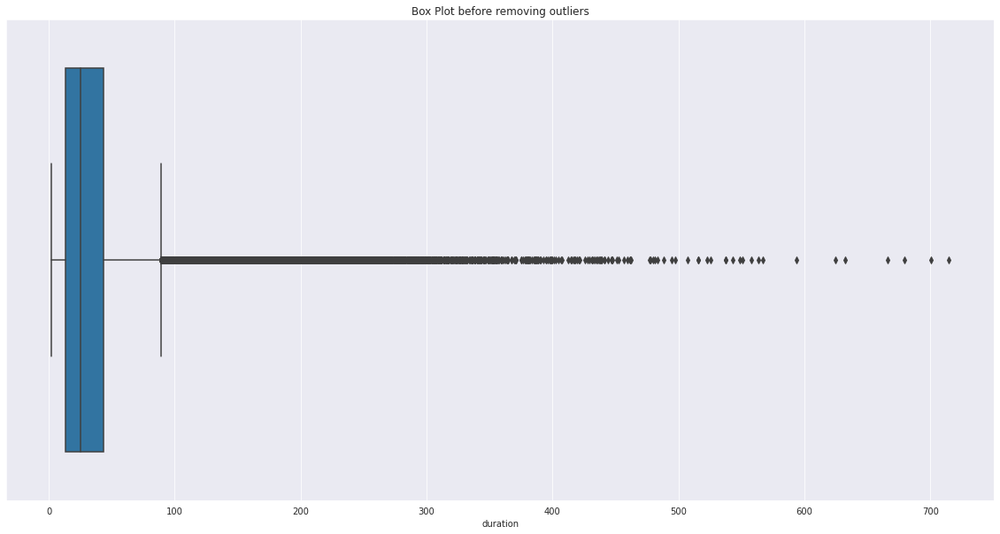

In [ ]:
fig, ax = plt.subplots(figsize=(20, 10))
 
sns.boxplot(df['duration']).set(title="Box Plot before removing outliers")
plt.show()

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning:

Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



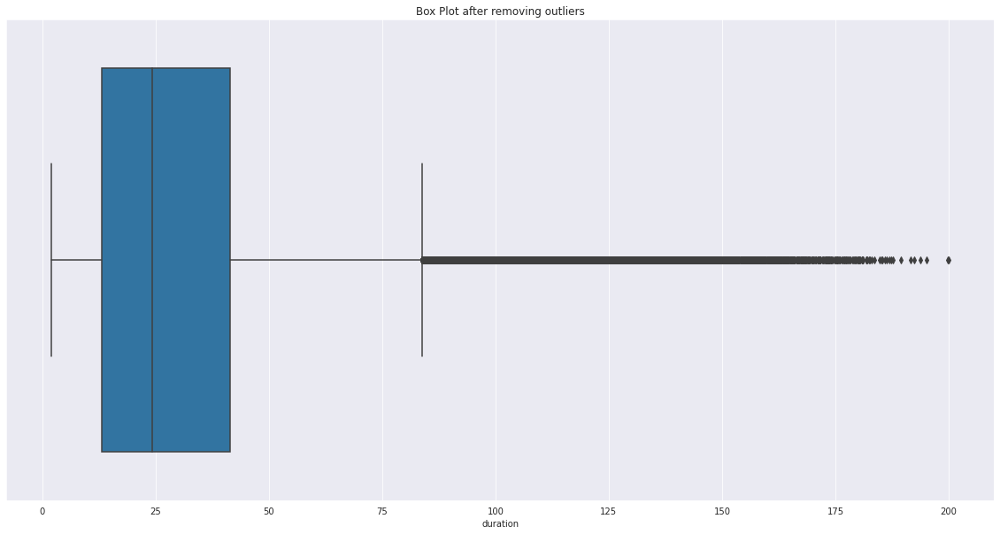

In [ ]:
fig, ax = plt.subplots(figsize=(20, 10))
 
sns.boxplot(df_wo_outliers['duration']).set(title="Box Plot after removing outliers")
plt.show()

In [ ]:
df_wo_outliers.describe()

,duration,monetary,recency,frequency
count,227604.000000,227604.000000,227604.000000,227604.000000
mean,31.333246,0.235716,14.686108,2.332745
std,26.188785,12.804183,9.533267,2.587139
min,2.000033,0.000000,0.000000,1.000000
25%,13.148950,0.000000,6.000000,1.000000
50%,24.242537,0.000000,15.000000,1.000000
75%,41.405613,0.000000,23.000000,3.000000
max,200.081917,2500.000000,30.000000,28.000000


In [ ]:
df_wo_outliers['duration'].describe()

count    227604.000000
mean         31.333246
std          26.188785
min           2.000033
25%          13.148950
50%          24.242537
75%          41.405613
max         200.081917
Name: duration, dtype: float64

In [ ]:
df_wo_outliers.to_csv("iso_rod.csv")

In [ ]:
# Get value with condition
df_all_od = df[df['duration'] > ]  
df_all_od['duration'].describe()

count    1187.000000
mean      280.000363
std        66.917794
min       219.009335
25%       235.127465
50%       260.059746
75%       298.917641
max       714.778732
Name: duration, dtype: float64

In [ ]:
df_all_od['duration'].to_csv("iso_od_0.01.csv")

### Monetary

In [ ]:
df_paid.head()

,duration,monetary,recency,frequency,account_id
0,117.249550,200,2,19,62d80ea81505f84bf054dc59
1,218.915418,100,0,8,62d80efb1505f84bf054dc77
2,79.135264,200,4,15,62d80f321505f84bf054dc87
3,256.817099,51900,0,31,62d80fe61505f84bf054dcc6
4,130.634784,450,0,31,62d8103b1505f84bf054dcec


In [ ]:
df_paid.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2259 entries, 0 to 2258
Data columns (total 5 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   duration    2259 non-null   float64
 1   monetary    2259 non-null   int64  
 2   recency     2259 non-null   int64  
 3   frequency   2259 non-null   int64  
 4   account_id  2259 non-null   object 
dtypes: float64(1), int64(3), object(1)
memory usage: 88.4+ KB


In [ ]:
df = df_paid.drop(columns=['account_id'])

In [ ]:
CONTAMINATION=.03  
BOOTSTRAP = False   

data = df.values

# X, y = data[:, :-1], data[:, -1]
X, y = data[:, :], data[:, -1]
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=1)

i_forest = IsolationForest(contamination=CONTAMINATION, bootstrap=BOOTSTRAP)
is_inlier = i_forest.fit_predict(X_train)    # +1 if inlier, -1 if outlier

mask = is_inlier != -1
X_train, y_train = X_train[mask, :], y_train[mask]

In [ ]:
df_wo_outliers=pd.DataFrame(X_train, columns=df.columns[:])                      
df_boxplot = pd.DataFrame(data={'With outliers':df['monetary'], 'Without outliers':df_wo_outliers['monetary']})
fig = px.box(df_boxplot)
fig.show()

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning:

Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



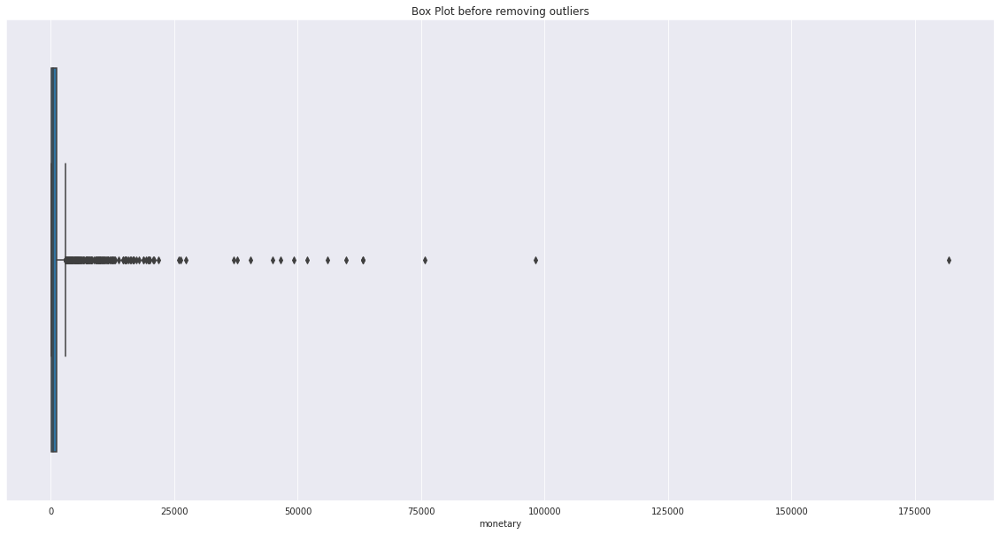

In [ ]:
fig, ax = plt.subplots(figsize=(20, 10))
 
sns.boxplot(df['monetary']).set(title="Box Plot before removing outliers")
plt.show()

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning:

Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



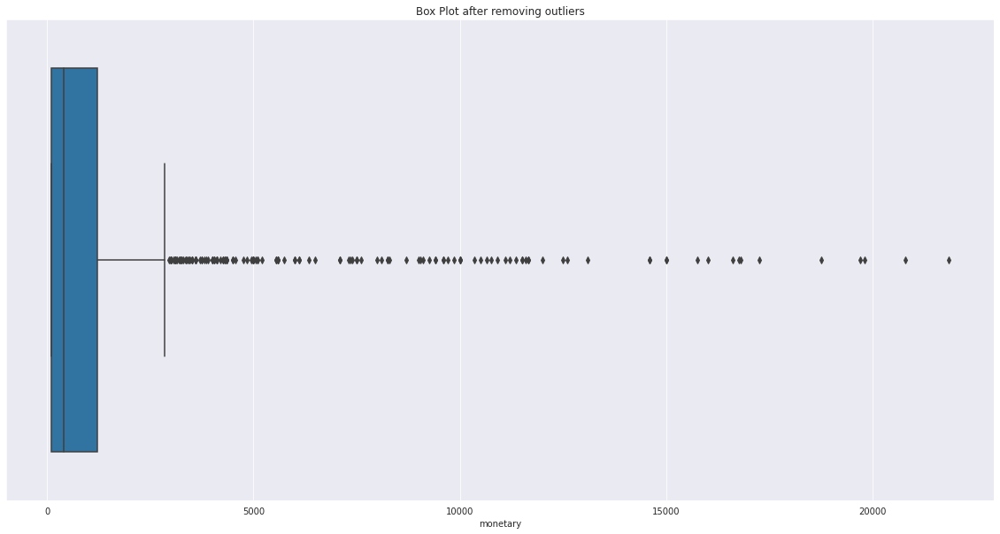

In [ ]:
fig, ax = plt.subplots(figsize=(20, 10))
 
sns.boxplot(df_wo_outliers['monetary']).set(title="Box Plot after removing outliers")
plt.show()

In [ ]:
df_wo_outliers.describe()

,duration,monetary,recency,frequency
count,1752.000000,1752.000000,1752.000000,1752.000000
mean,108.572254,1170.062785,4.605023,18.697489
std,61.714154,2319.401729,7.464696,10.880265
min,2.885951,100.000000,0.000000,1.000000
25%,61.489318,100.000000,0.000000,8.000000
50%,97.257888,400.000000,0.000000,20.000000
75%,141.878342,1212.500000,6.000000,30.000000
max,354.603130,21850.000000,30.000000,31.000000


In [ ]:
df_wo_outliers['monetary'].describe()

count     1752.000000
mean      1170.062785
std       2319.401729
min        100.000000
25%        100.000000
50%        400.000000
75%       1212.500000
max      21850.000000
Name: monetary, dtype: float64

In [ ]:
df_wo_outliers.to_csv("t11_iso_rom.csv")

In [ ]:
# Get value with condition
df_paid_om = df[df['monetary'] > 21850.000000]  
df_paid_om['monetary'].describe()

count        17.000000
mean      57982.352941
std       36976.271704
min       26000.000000
25%       37750.000000
50%       49300.000000
75%       63100.000000
max      181900.000000
Name: monetary, dtype: float64

In [ ]:
df_paid_om['monetary'].to_csv("iso_om_0.03.csv")

## Method One class SVM

In [ ]:
from sklearn.svm import OneClassSVM
import pandas as pd
from pandas import DataFrame
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from matplotlib.pyplot import figure

In [ ]:
from sklearn.metrics import classification_report

### Duration

In [ ]:
df_all_rn.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 169841 entries, 0 to 174137
Data columns (total 5 columns):
 #   Column      Non-Null Count   Dtype  
---  ------      --------------   -----  
 0   account_id  169841 non-null  object 
 1   recency     169841 non-null  int64  
 2   frequency   169841 non-null  int64  
 3   duration    169841 non-null  float64
 4   moneytary   169841 non-null  int64  
dtypes: float64(1), int64(3), object(1)
memory usage: 7.8+ MB


In [ ]:
df = df_all_rn.drop(columns=['account_id'])

In [ ]:
data = df.values

X, y = data[:, :], data[:, -1]
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=1)
model_ocs = OneClassSVM(nu=0.03, kernel="rbf", gamma='scale')
is_inlier = model_ocs.fit_predict(X_train)    # +1 if inlier, -1 if outlier

mask = is_inlier != -1
X_train, y_train = X_train[mask, :], y_train[mask]

In [ ]:
from sklearn.metrics \
import (confusion_matrix, precision_score,recall_score)

In [ ]:
confusion_matrix(is_inlier, mask)

array([[     0,   4074,      0],
       [     0,      0,      0],
       [     0,      0, 131798]])

In [ ]:
# model_ocs.accuracy_score(X_test, y_test)

In [ ]:
df_wo_outliers=pd.DataFrame(X_train, columns=df.columns[:])                      
df_boxplot = pd.DataFrame(data={'With outliers':df['duration'], 'Without outliers':df_wo_outliers['duration']})
fig = px.box(df_boxplot)
fig.show()

In [ ]:
# threedee = plt.figure(figsize=(15,15)).gca(projection='3d')
# threedee.scatter(df.index, df['duration'], df['moneytary'])
# threedee.scatter(df_od.index, df_od["duration"], df_od["moneytary"], c = "r")
# threedee.set_xlabel('moneytary')
# threedee.set_ylabel('index')
# threedee.set_zlabel('duration')
# plt.show()

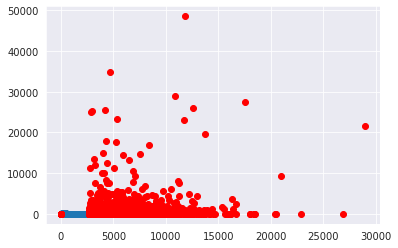

In [ ]:
# plt.scatter(df_wo_outliers["duration"], df_wo_outliers["moneytary"])
# plt.scatter(df_od["duration"], df_od["moneytary"], c = "r")

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning:

Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



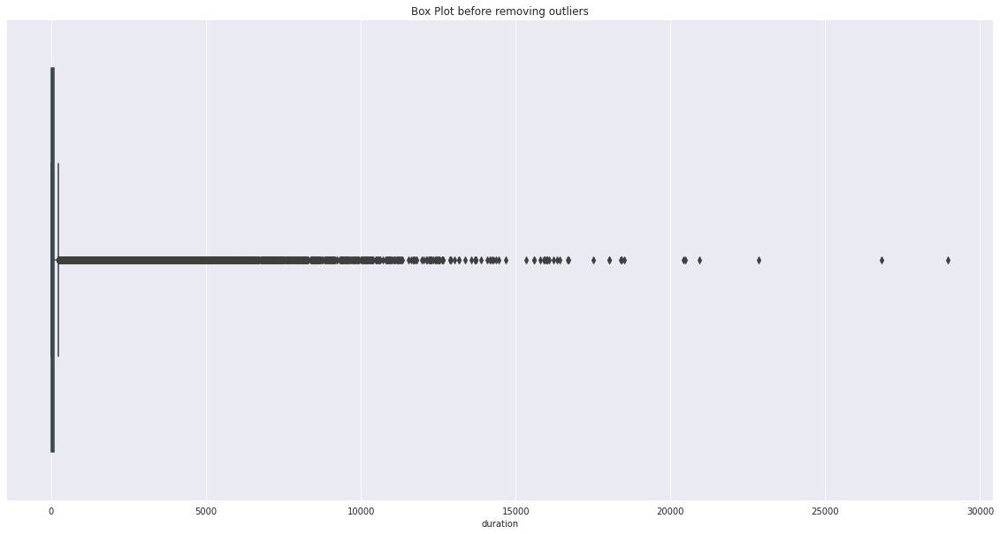

In [ ]:
fig, ax = plt.subplots(figsize=(20, 10))
 
sns.boxplot(df['duration']).set(title="Box Plot before removing outliers")
plt.show()

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning:

Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



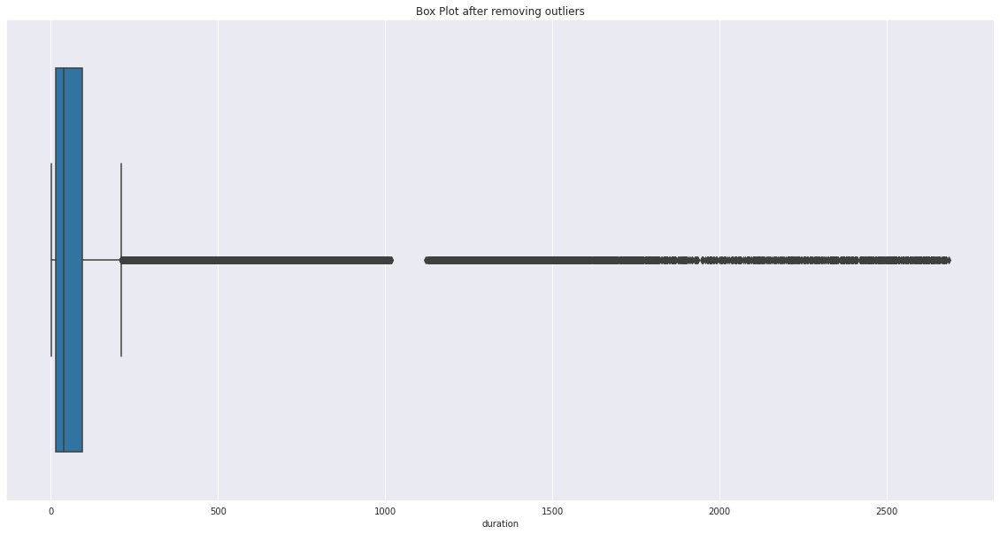

In [ ]:
fig, ax = plt.subplots(figsize=(20, 10))
 
sns.boxplot(df_wo_outliers['duration']).set(title="Box Plot after removing outliers")
plt.show()

In [ ]:
df_wo_outliers['duration'].describe()

count    131798.000000
mean        112.808628
std         248.273125
min           2.103967
25%          16.663642
50%          39.783399
75%          94.632919
max        2685.792277
Name: duration, dtype: float64

In [ ]:
df_wo_outliers.to_csv("t11_ocs_rod.csv")

In [ ]:
df_wo_outliers['moneytary'].describe()

count    131798.000000
mean          0.220034
std           4.876075
min           0.000000
25%           0.000000
50%           0.000000
75%           0.000000
max         200.000000
Name: moneytary, dtype: float64

In [ ]:
df_od = df[(df['duration'] > 2685.792277) | (df['duration']<2.103967)]

In [ ]:
df_od['duration'].describe()

count     2564.000000
mean      4574.115897
std       2892.057752
min          2.000317
25%       3051.278702
50%       3872.932947
75%       5498.682537
max      28971.547537
Name: duration, dtype: float64

In [ ]:
df_od['duration'].to_csv("t11_ocs_od.csv")

### Monetary

In [ ]:
df_all_rn.head()

,account_id,recency,frequency,duration,moneytary
0,62a02cd3a3815feccbb7915a,14,3,15.711350,0
1,62a2e9d7a3815feccbb79179,2,1,30.814383,0
2,62a3a777a3815feccbb7917e,5,1,2.033133,0
3,62a69da1a3815feccbb79184,1,2,4.022383,0
4,62a6eb19a3815feccbb79188,5,2,17.677450,0


In [ ]:
df_all_rn.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 169841 entries, 0 to 174137
Data columns (total 5 columns):
 #   Column      Non-Null Count   Dtype  
---  ------      --------------   -----  
 0   account_id  169841 non-null  object 
 1   recency     169841 non-null  int64  
 2   frequency   169841 non-null  int64  
 3   duration    169841 non-null  float64
 4   moneytary   169841 non-null  int64  
dtypes: float64(1), int64(3), object(1)
memory usage: 11.8+ MB


In [ ]:
df = df_all_rn.drop(columns=['account_id'])

In [ ]:
data = df.values

X, y = data[:, :], data[:, -1]
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=1)
model_ocs = OneClassSVM(nu=0.03, kernel="rbf", gamma='scale')
is_inlier = model_ocs.fit_predict(X_train)    # +1 if inlier, -1 if outlier

mask = is_inlier != -1
X_train, y_train = X_train[mask, :], y_train[mask]

In [ ]:
df_wo_outliers=pd.DataFrame(X_train, columns=df.columns[:])                      
df_boxplot = pd.DataFrame(data={'With outliers':df['moneytary'], 'Without outliers':df_wo_outliers['moneytary']})
fig = px.box(df_boxplot)
fig.show()

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning:

Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



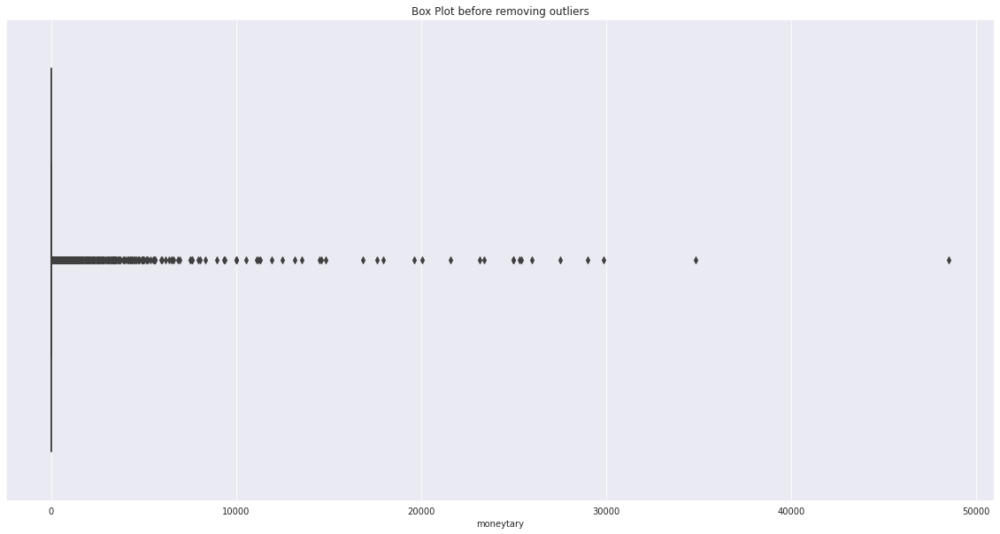

In [ ]:
fig, ax = plt.subplots(figsize=(20, 10))
 
sns.boxplot(df['moneytary']).set(title="Box Plot before removing outliers")
plt.show()

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning:

Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



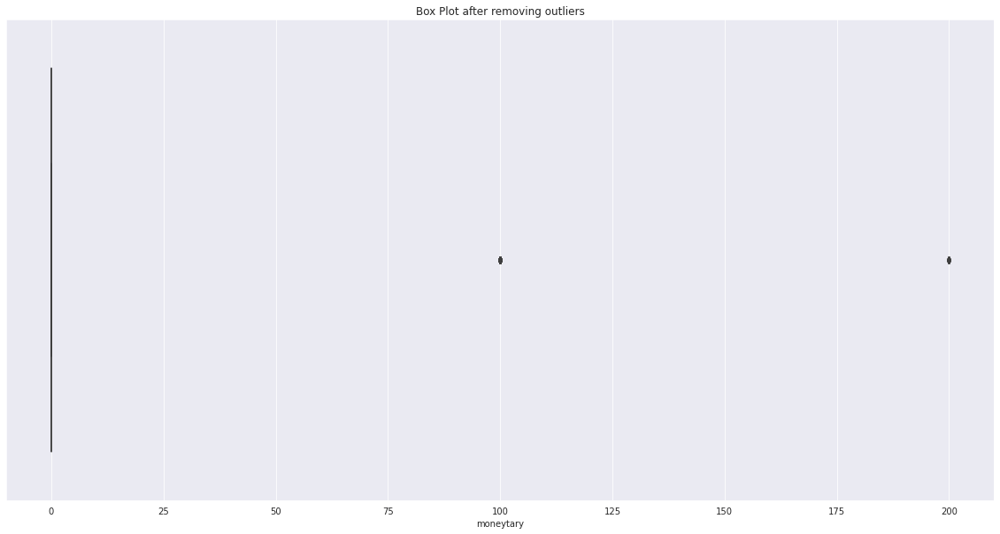

In [ ]:
fig, ax = plt.subplots(figsize=(20, 10))
 
sns.boxplot(df_wo_outliers['moneytary']).set(title="Box Plot after removing outliers")
plt.show()

In [ ]:
df_wo_outliers['moneytary'].describe()

count    131798.000000
mean          0.220034
std           4.876075
min           0.000000
25%           0.000000
50%           0.000000
75%           0.000000
max         200.000000
Name: moneytary, dtype: float64

In [ ]:
df_wo_outliers.to_csv("t11_ocs_rom.csv")

In [ ]:
# Get value with condition
df_paid_om = df[df['moneytary'] > 200]  
df_paid_om['moneytary'].describe()

count      933.000000
mean      1979.635584
std       3936.611209
min        250.000000
25%        500.000000
50%        850.000000
75%       1850.000000
max      48550.000000
Name: moneytary, dtype: float64

In [ ]:
df_paid_om['moneytary'].to_csv("t11_ocs_om.csv")

## Method KNN

In [ ]:
!pip install pyod

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
from pyod.models.knn import KNN
from sklearn.linear_model import LinearRegression

### Duration

In [ ]:
df_paid.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2259 entries, 0 to 2258
Data columns (total 5 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   duration    2259 non-null   float64
 1   monetary    2259 non-null   int64  
 2   recency     2259 non-null   int64  
 3   frequency   2259 non-null   int64  
 4   account_id  2259 non-null   object 
dtypes: float64(1), int64(3), object(1)
memory usage: 88.4+ KB


In [ ]:
df = df_paid.drop(columns=['account_id'])

In [ ]:
df

,duration,monetary,recency,frequency
0,117.249550,200,2,19
1,218.915418,100,0,8
2,79.135264,200,4,15
3,256.817099,51900,0,31
4,130.634784,450,0,31
...,...,...,...,...
2254,148.804401,100,0,1
2255,162.692703,100,0,1
2256,209.141602,100,0,1
2257,34.561550,2500,0,1


In [ ]:
knn = KNN(contamination=0.01, n_neighbors=20, n_jobs=-1)
knn.fit(df)

is_outlier = knn.labels_ == 1

# Isolate the outliers
outliers = df[is_outlier]

print(len(outliers))

23


In [ ]:
outliers.describe()

,duration,monetary,recency,frequency
count,23.000000,23.000000,23.000000,23.000000
mean,173.058747,48217.391304,2.304348,23.782609
std,67.313605,35734.467728,4.557060,8.190663
min,82.621965,19800.000000,0.000000,6.000000
25%,124.785715,23925.000000,0.000000,19.500000
50%,168.864462,40500.000000,0.000000,27.000000
75%,226.740538,57950.000000,2.000000,31.000000
max,352.698276,181900.000000,16.000000,31.000000


In [ ]:
outliers.to_csv("knn_om.csv")

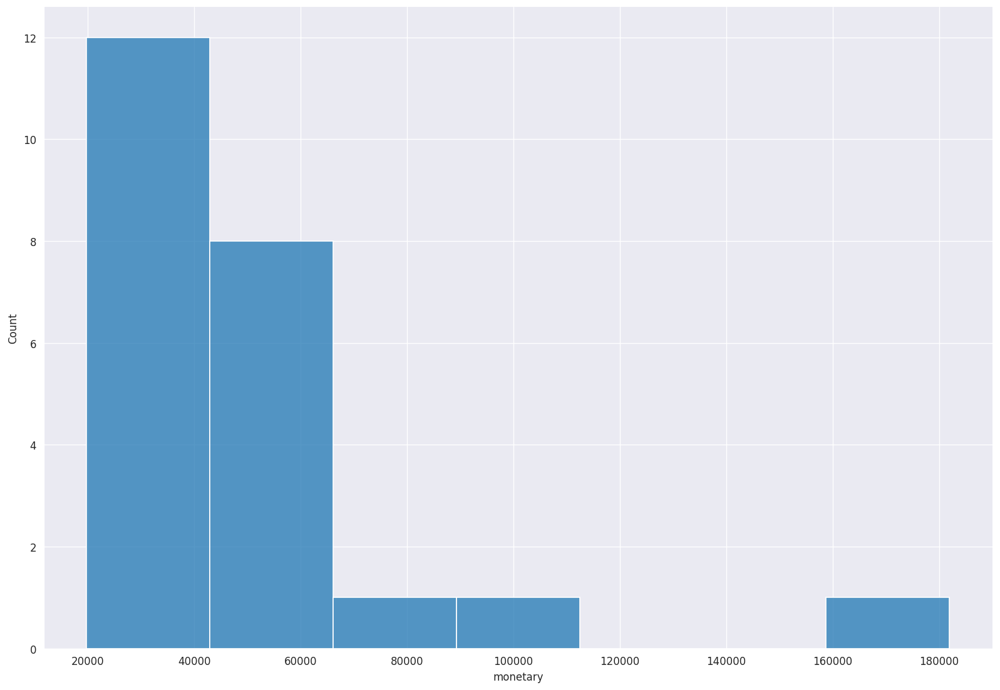

In [ ]:
p = sns.displot(outliers['monetary'])
p.fig.set_figwidth(15)
p.fig.set_figheight(10)
p.fig.set_dpi(120)

### Monetary

## Method LOF

In [ ]:
from pyod.models.lof import LOF

In [ ]:
df = df_all_rn.drop(columns=['account_id'])

In [ ]:
lof = LOF(contamination=0.05, n_neighbors=20, n_jobs=-1)
lof.fit(df)

# Create a boolean index that checks for outliers
is_outlier = lof.labels_ == 1

outliers = df[is_outlier]

print(len(outliers))

14666


In [ ]:
outliers.describe()

,duration,monetary,recency,frequency
count,14666.000000,14666.000000,14666.000000,14666.000000
mean,13.235393,69.388381,18.055298,1.112778
std,20.310857,2320.927551,9.612684,1.537562
min,2.003800,0.000000,0.000000,1.000000
25%,5.951913,0.000000,10.000000,1.000000
50%,9.645233,0.000000,21.000000,1.000000
75%,17.472550,0.000000,27.000000,1.000000
max,714.778732,181900.000000,30.000000,31.000000


In [ ]:
outliers.to_csv("lof_od.csv")

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


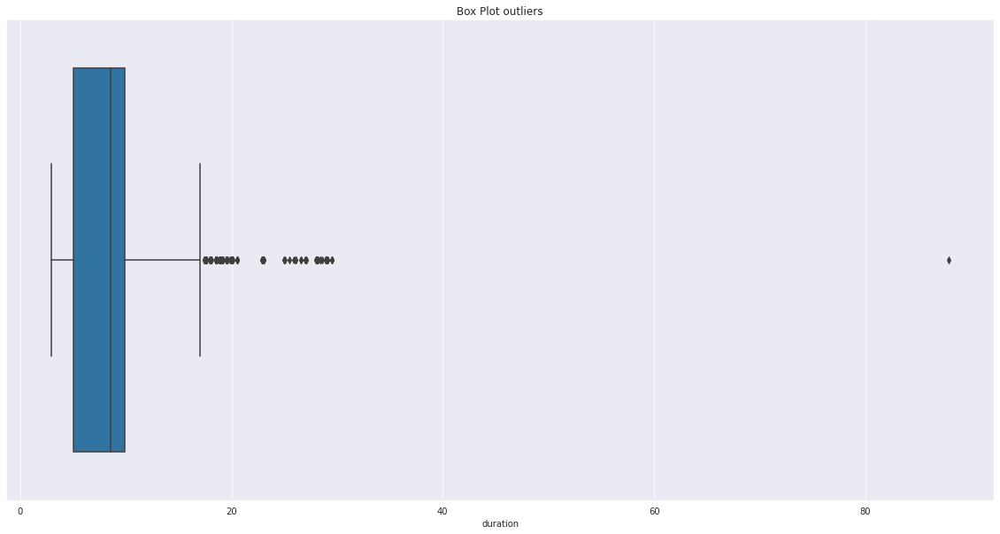

In [ ]:
fig, ax = plt.subplots(figsize=(20, 10))
 
sns.boxplot(outliers['duration']).set(title="Box Plot outliers")
plt.show()

In [ ]:
# xs
# Instantiate an LOF with 20 neighbors and fit to the data
lof = LOF(n_neighbors=20, n_jobs=-1)
lof.fit(df)

# Calculate probabilities
probs = lof.predict_proba(df)

# Create a boolean mask
is_outlier = probs[:, 1] > 0.50

# Use the boolean mask to filter the outliers
outliers = df[is_outlier]

print(len(outliers))

60


In [ ]:
outliers.describe()

,duration,monetary,recency,frequency
count,1467.000000,1467.000000,1467.000000,1467.000000
mean,9.320782,123.994547,17.090661,1.008180
std,5.801498,4749.169195,8.997458,0.313304
min,2.947433,0.000000,0.000000,1.000000
25%,5.039783,0.000000,10.000000,1.000000
50%,8.566133,0.000000,17.000000,1.000000
75%,9.932425,0.000000,24.000000,1.000000
max,87.922915,181900.000000,30.000000,13.000000


# Process missing data

+ Bỏ qua
+ Xử lý tay (không tự động, bán tự động)
+ Dùng giá trị thay thế (tự động): hằng số toàn cục, trị phổ biến nhất,
trung bình toàn cục, trung bình cục bộ, trị dự đoán, …
+ Ngăn chặn dữ liệu bị thiếu: thiết kế tốt CSDL và các thủ tục nhập
liệu (các ràng buộc dữ liệu)

# Clustering kmeans

In [ ]:
# Load packages
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans

# Set visualization style
sns.set_style("darkgrid")

# Load the data and replace with your CSV file path
df = pd.read_csv("/content/drive/MyDrive/FTECHAI/dataset/T11/data_t11.csv")
df = df.drop(columns=['account_id'])
# Preview the data
df

,recency,frequency,duration,moneytary
0,14,3,15.711350,0
1,2,1,30.814383,0
2,5,1,2.033133,0
3,1,2,4.022383,0
4,5,2,17.677450,0
...,...,...,...,...
174133,0,1,6.490567,0
174134,0,1,57.539951,0
174135,0,1,19.862101,0
174136,0,1,1.227600,0


In [ ]:
# Check columns for data types and missing values
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 174138 entries, 0 to 174137
Data columns (total 4 columns):
 #   Column     Non-Null Count   Dtype  
---  ------     --------------   -----  
 0   recency    174138 non-null  int64  
 1   frequency  174138 non-null  int64  
 2   duration   174138 non-null  float64
 3   moneytary  174138 non-null  int64  
dtypes: float64(1), int64(3)
memory usage: 5.3 MB


In [ ]:
# Select columns for clustering
# columns_for_clustering = ["duration", "recency","frequency", "monetary"]
columns_for_clustering = ["duration", "recency","frequency", "moneytary"]

# Create new DataFrame with clustering variables
df_features = df[columns_for_clustering]

# Print a summary of descriptive statistics
df_features.describe()

,duration,recency,frequency,moneytary
count,174138.000000,174138.000000,174138.000000,174138.000000
mean,189.818594,13.096280,2.953198,11.002768
std,701.964212,9.092263,4.487542,322.287742
min,0.047900,0.000000,1.000000,0.000000
25%,15.645354,4.000000,1.000000,0.000000
50%,39.435925,12.000000,1.000000,0.000000
75%,99.414568,21.000000,3.000000,0.000000
max,28971.547537,29.000000,30.000000,48550.000000


In [ ]:
# df_features = df_features.astype(float)

In [ ]:
# df_features_new = df_features[np.isfinite(df_features).all(1)]

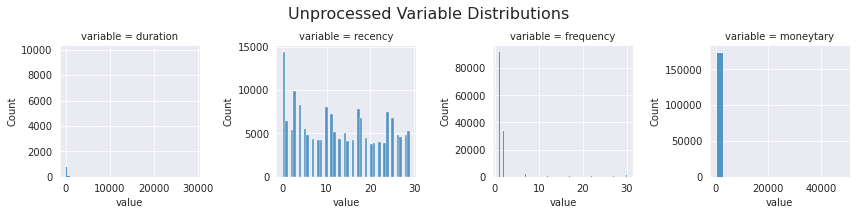

In [ ]:
# Plot the distributions of the selected variables
g = sns.FacetGrid(
    df_features.melt(),  # Reformat the DataFrame for plotting purposes
    col="variable",  # Split on the 'variable' column created by reformating
    sharey=False,  # Turn off shared y-axis
    sharex=False,  # Turn off shared x-axis
)
# Apply a histogram to the facet grid
g.map(sns.histplot, "value")
# Adjust the top of the plots to make room for the title
g.fig.subplots_adjust(top=0.8)
# Create a title
g.fig.suptitle("Unprocessed Variable Distributions", fontsize=16)
plt.show()

In [ ]:
all([pd.api.types.is_numeric_dtype(df_features[col]) for col in columns_for_clustering])

True

In [ ]:
df_log = np.log(df_features)

In [ ]:
df_log

,duration,recency,frequency,moneytary
0,2.754383,2.639057,1.098612,-inf
1,3.427982,0.693147,0.000000,-inf
2,0.709578,1.609438,0.000000,-inf
3,1.391875,0.000000,0.693147,-inf
4,2.872290,1.609438,0.693147,-inf
...,...,...,...,...
174133,1.870350,-inf,0.000000,-inf
174134,4.052480,-inf,0.000000,-inf
174135,2.988813,-inf,0.000000,-inf
174136,0.205061,-inf,0.000000,-inf


In [ ]:
df_log.replace([np.inf, -np.inf], np.nan, inplace=True)

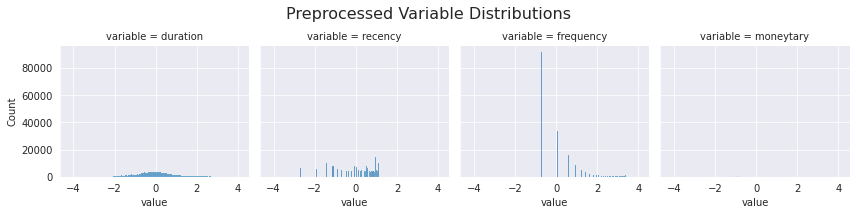

In [ ]:
# Perform a log transformation of the data to unskew the data
# df_log = np.log(df_features)

# Initialize a standard scaler and fit it
scaler = StandardScaler()
scaler.fit(df_log)

# Scale and center the data
df_normalized = scaler.transform(df_log)

# Create a pandas DataFrame of the processed data
df_processed = pd.DataFrame(
    data=df_normalized, index=df_features.index, columns=df_features.columns
)

# Plot the distributions of the selected variables
g = sns.FacetGrid(df_processed.melt(), col="variable")
g.map(sns.histplot, "value")
g.fig.subplots_adjust(top=0.8)
g.fig.suptitle("Preprocessed Variable Distributions", fontsize=16)
plt.show()

In [ ]:
df_processed

,duration,recency,frequency,moneytary
0,-0.609259,0.301607,0.597344,NaN
1,-0.185499,-1.917612,-0.751430,NaN
2,-1.895646,-0.872625,-0.751430,NaN
3,-1.466413,-2.708114,0.099552,NaN
4,-0.535084,-0.872625,0.099552,NaN
...,...,...,...,...
174133,-1.165405,NaN,-0.751430,NaN
174134,0.207373,NaN,-0.751430,NaN
174135,-0.461779,NaN,-0.751430,NaN
174136,-2.213038,NaN,-0.751430,NaN


In [ ]:
df_processed.replace([np.inf, -np.inf], np.nan, inplace=True)

In [ ]:
np.any(np.isnan(df_processed))

True

In [ ]:
np.all(np.isfinite(df_processed))

False

In [ ]:
# def clean_dataset(df_processed):
#     assert isinstance(df_processed, pd.DataFrame), "df needs to be a pd.DataFrame"
#     df_processed.dropna(inplace=True)
#     indices_to_keep = ~df_processed.isin([np.nan, np.inf, -np.inf]).any(1)
#     return df_processed[indices_to_keep].astype(np.float64)

In [ ]:
df_processed.replace([np.inf,-np. inf], np.nan, inplace=True)
df_processed.dropna (inplace=True)

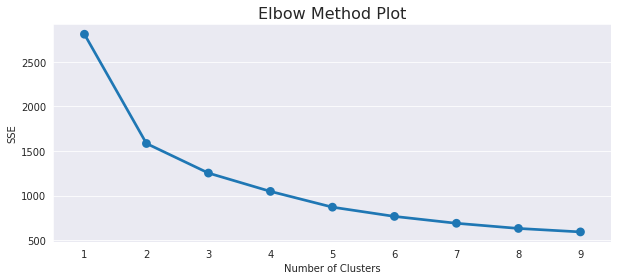

In [ ]:
max_clusters = 10

# sum of squared errors
sse = {}
# Fit KMeans and calculate SSE for each k
for k in range(1, max_clusters):
    # Initialize KMeans with k clusters
    kmeans = KMeans(n_clusters=k, random_state=1)
    # Fit KMeans on the normalized dataset
    kmeans.fit(df_processed)
    # Assign sum of squared distances to k element of dictionary
    sse[k] = kmeans.inertia_

plt.figure(figsize=(10, 4))

sns.pointplot(x=list(sse.keys()), y=list(sse.values()))

# Add labels to the plot
plt.title("Elbow Method Plot", fontsize=16) 
plt.xlabel("Number of Clusters")  
plt.ylabel("SSE")  

plt.show()

In [ ]:
k = 3

kmeans = KMeans(n_clusters=k, random_state=1) 
kmeans.fit(df_processed)
cluster_labels = kmeans.labels_
# df_clustered = df.assign(Cluster=cluster_labels)
df_clustered = df_processed.assign(Cluster=cluster_labels)
df_clustered

,duration,recency,frequency,moneytary,Cluster
21,-0.256115,0.453893,0.099552,-1.094088,0
33,2.807821,-0.336608,2.726925,0.698862,1
35,3.197193,-2.708114,2.573262,0.245643,2
175,1.184762,-1.917612,2.299307,0.109318,2
267,1.683837,-2.708114,2.397576,0.245643,2
...,...,...,...,...,...
166437,0.220937,-1.917612,-0.751430,-0.408960,0
167661,0.866007,-1.917612,-0.751430,-1.094088,0
167951,0.983447,-2.708114,0.099552,0.245643,2
168482,1.066444,-2.708114,0.099552,-1.094088,0


In [ ]:
filter_0 = df_clustered[df_clustered['Cluster'] == 0]

In [ ]:
filter_0

,duration,recency,frequency,moneytary,Cluster
21,-0.256115,0.453893,0.099552,-1.094088,0
403,1.524483,0.026573,1.224488,-1.094088,0
633,0.647169,0.916307,0.597344,0.109318,0
772,-0.381440,0.708378,0.099552,0.794445,0
905,0.628023,-0.872625,0.597344,1.087582,0
...,...,...,...,...,...
161859,1.091509,-1.917612,0.099552,-0.272635,0
166437,0.220937,-1.917612,-0.751430,-0.408960,0
167661,0.866007,-1.917612,-0.751430,-1.094088,0
168482,1.066444,-2.708114,0.099552,-1.094088,0


In [ ]:
filter_0

,duration,recency,frequency,moneytary,Cluster
21,-0.256115,0.453893,0.099552,-1.094088,0
403,1.524483,0.026573,1.224488,-1.094088,0
633,0.647169,0.916307,0.597344,0.109318,0
772,-0.381440,0.708378,0.099552,0.794445,0
905,0.628023,-0.872625,0.597344,1.087582,0
...,...,...,...,...,...
161859,1.091509,-1.917612,0.099552,-0.272635,0
166437,0.220937,-1.917612,-0.751430,-0.408960,0
167661,0.866007,-1.917612,-0.751430,-1.094088,0
168482,1.066444,-2.708114,0.099552,-1.094088,0


In [ ]:
df_sizes = df_clustered.groupby(["Cluster"], as_index=False).size()
df_sizes

,Cluster,size
0,0,207
1,1,198
2,2,196


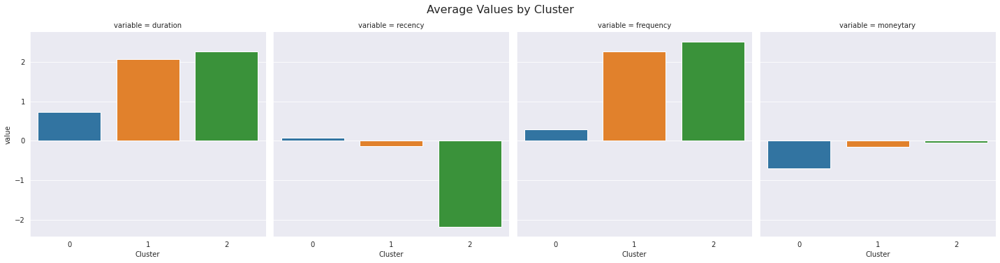

In [ ]:
df_means = df_clustered.groupby(["Cluster"])[df_features.columns].mean().reset_index()

sns.catplot(
    data=df_means.melt(id_vars="Cluster"),  # Transform the data to enable plotting
    col="variable",
    x="Cluster",
    y="value",
    kind="bar",
)

plt.suptitle("Average Values by Cluster", y=1.04, fontsize=16)

plt.show()

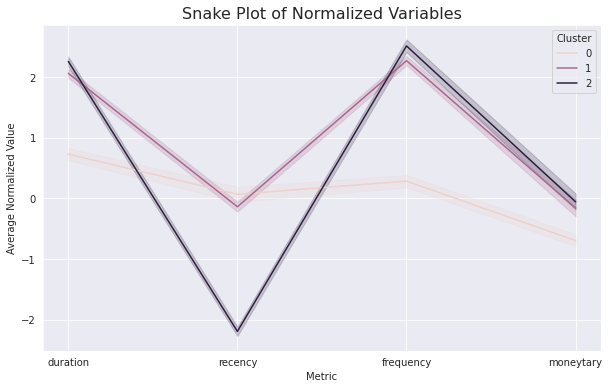

In [ ]:
# Create a snake plot of the clusters
df_processed_clustered = df_processed.assign(Cluster=cluster_labels)

df_processed_melt = pd.melt(
    df_processed_clustered.reset_index(),
    id_vars=['Cluster'],
    value_vars=df_features.columns,
    var_name="Metric",
    value_name="Value",
)

plt.figure(figsize=(10, 6))

plt.title('Snake Plot of Normalized Variables', fontsize=16)
plt.xlabel('Metric')
plt.ylabel('Average Normalized Value')

sns.lineplot(data=df_processed_melt, x='Metric', y='Value', hue='Cluster')
plt.show()

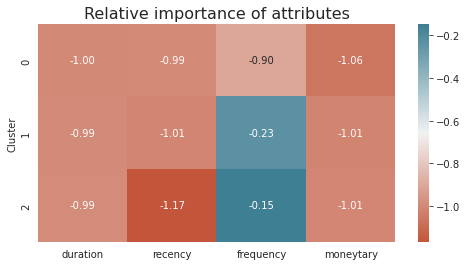

In [ ]:
# Create heatmap of relative importances
cluster_avg = df_clustered.groupby(["Cluster"])[columns_for_clustering].mean()

population_avg = df[columns_for_clustering].mean()

relative_imp = cluster_avg / population_avg - 1

plt.figure(figsize=(8, 4))

plt.title("Relative importance of attributes", fontsize=16)

sns.heatmap(data=relative_imp, annot=True, fmt=".2f", cmap=sns.diverging_palette(20, 220, as_cmap=True))
plt.show()

# Clustering

In [ ]:
df_all_rn

,duration,monetary,recency,frequency,account_id
0,714.778732,0,0,3,635c8cf81505f828cf79d3d6
1,700.352309,0,16,1,6349a08e1505f828cf787f36
2,679.467301,300,0,7,635724051505f828cf798504
3,665.620019,0,0,31,631dcac71505f8fb5aab0c72
4,632.563903,0,13,1,634dfd161505f828cf78de64
...,...,...,...,...,...
293300,2.001217,0,11,1,6350f59a1505f828cf790c1f
293301,2.000583,0,13,1,634e61951505f828cf78e4f8
293302,2.000483,0,10,1,63526ed21505f828cf7923ea
293303,2.000117,0,8,1,630d9e051505f8fb5aa87708


In [ ]:
df = df_all_rn.drop(columns=['account_id'])

In [ ]:
duration_quartile = pd.qcut(df['duration'], q=4, labels=range(1,5))

df['duration_quartile'] = duration_quartile

print(df.sort_values('duration'))

          duration  monetary  recency  frequency duration_quartile
293304    2.000033         0        5          1                 1
293303    2.000117         0        8          1                 1
293302    2.000483         0       10          1                 1
293301    2.000583         0       13          1                 1
293300    2.001217         0       11          1                 1
...            ...       ...      ...        ...               ...
4       632.563903         0       13          1                 4
3       665.620019         0        0         31                 4
2       679.467301       300        0          7                 4
1       700.352309         0       16          1                 4
0       714.778732         0        0          3                 4

[293305 rows x 5 columns]


In [ ]:
# Assigning labels
r_labels = list(range(4, 0, -1))

recency_quartiles = pd.qcut(df['recency'], q=4, labels=r_labels)

df['recency_quartile'] = recency_quartiles 

print(df.sort_values('recency'))

          duration  monetary  recency  frequency duration_quartile  \
0       714.778732         0        0          3                 4   
47488    56.706719         0        0         26                 4   
233825   11.220434         0        0          1                 1   
137290   26.726765         0        0         11                 3   
17244    92.429273         0        0          2                 4   
...            ...       ...      ...        ...               ...   
98138    35.606833         0       30          1                 3   
274621    4.989600         0       30          1                 1   
274620    4.989600         0       30          1                 1   
166739   21.481934         0       30          1                 2   
47661    56.583998         0       30          1                 4   

       recency_quartile  
0                     4  
47488                 4  
233825                4  
137290                4  
17244                 4  
...

In [ ]:
# Custom label
r_labels = ['Activate', 'Lapsed', 'Inactive', 'Churned']
recency_quartiles = pd.qcut(df['recency'], q=4, labels=r_labels)
df['recency_quartile'] = recency_quartiles
df.sort_values('recency')

,duration,monetary,recency,frequency,duration_quartile,recency_quartile
0,714.778732,0,0,3,4,Activate
47488,56.706719,0,0,26,4,Activate
233825,11.220434,0,0,1,1,Activate
137290,26.726765,0,0,11,3,Activate
17244,92.429273,0,0,2,4,Activate
...,...,...,...,...,...,...
98138,35.606833,0,30,1,3,Churned
274621,4.989600,0,30,1,1,Churned
274620,4.989600,0,30,1,1,Churned
166739,21.481934,0,30,1,2,Churned


# Test

In [ ]:
import numpy as np 
import pandas as pd 

In [ ]:
df = pd.read_csv("/content/mon.csv", index_col=False)
df.head()

,monetary
0,21850
1,20900
2,20800
3,20000
4,19950


In [ ]:
df.describe()

,monetary
count,2242.000000
mean,1258.251561
std,2521.821529
min,100.000000
25%,100.000000
50%,450.000000
75%,1250.000000
max,21850.000000


In [ ]:
df2 = df[df.monetary < 200]
# Chỉ lấy các giá trị theo đk 
# df3 = df[df.duration >400]

print(df2)

      monetary
1474       100
1475       100
1476       100
1477       100
1478       100
...        ...
2237       100
2238       100
2239       100
2240       100
2241       100

[768 rows x 1 columns]


In [ ]:
df2.describe()

,monetary
count,768.0
mean,100.0
std,0.0
min,100.0
25%,100.0
50%,100.0
75%,100.0
max,100.0


In [ ]:
# df3.to_csv("o2.csv")

In [ ]:
df.describe()

,duration
count,7301.000000
mean,5.696269
std,47.019033
min,0.044717
25%,0.771283
50%,1.158717
75%,1.591433
max,714.778732
